# Using different dataset, explore parameter space for OpenCV Bilateral and Convlution/average filters
- See if optimal parameters vary wrt to dataset
- Metrics: visual check for now, maybe also image similarity metric
<br>
Hypothesis: For Convolution Filter, optimal is 3x3 kernel with denominator k^2-1. For Bilateral, optimal is d = 9, s = 70
#### Notes: 
- Using Beijing Taxi dataset and Twitter Check-In dataset
#### Findings: 
- The "k^2-1" trick for choosing a denomiator that was used for the Beijing Taxi Data didn't work as well will the sparse Twitter Check-In data. Too much noise AND data was lost.

In [54]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline

In [53]:
dpi = 256

In [29]:
def plotComparison(original, openCV_out, method):
    plt.subplot(121),plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB)),plt.title('Base')
    plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(cv2.cvtColor(openCV_out, cv2.COLOR_BGR2RGB)),plt.title(method)
    plt.xticks([]), plt.yticks([])
    plt.show()

In [30]:
def save_256px(openCV_out, method):
    fig = plt.figure(figsize=(5, 5))
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    ax.imshow(cv2.cvtColor(openCV_out, cv2.COLOR_BGR2RGB))
    plt.savefig('OpenCV_Bilateral_Convolution/'+ method + '.png', pad_inches=0, dpi=dpi / 5.0)

# Base Images (Beijing Taxi Data)
Original: in_1E8.png 
<br>
Noisy: out_Identity_1E8_e1E-1.png

In [31]:
orig = cv2.imread('BeijingTaxiData/in_1E8.png')
img = cv2.imread('BeijingTaxiData/out_Identity_1E8_e1E-1.png')
nneg = cv2.imread('BeijingTaxiData/out_Identity_1E8_e1E-1_nonNeg.png')

# Averaging
- Apply custom-made filters to images (2D convolution)
<br>
- As in one-dimensional signals, images also can be filtered with various low-pass filters(LPF), high-pass filters(HPF) etc. LPF helps in removing noises, blurring the images etc. HPF filters helps in finding edges in the images.
<br>
- OpenCV provides a function cv2.filter2D() to convolve a kernel with an image. (*An AVERAGING filter would have the kernel size squared on the denominator)
<br>
- https://docs.opencv.org/3.1.0/d4/d86/group__imgproc__filter.html#ga27c049795ce870216ddfb366086b5a04

In [32]:
kernelSize = [2, 3, 5]
denom = [(2, 0), (2, 1), (3, 0)]

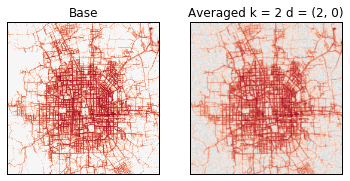

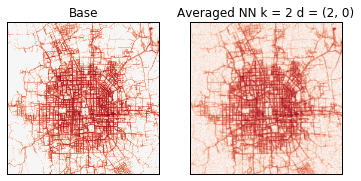

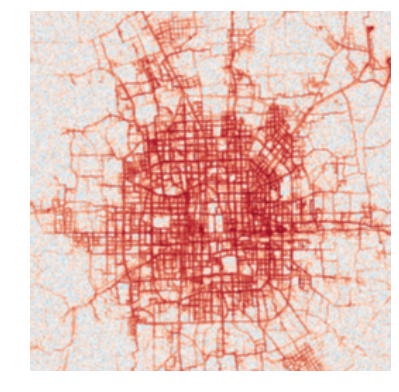

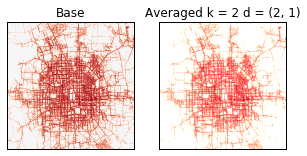

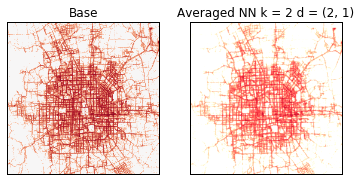

...

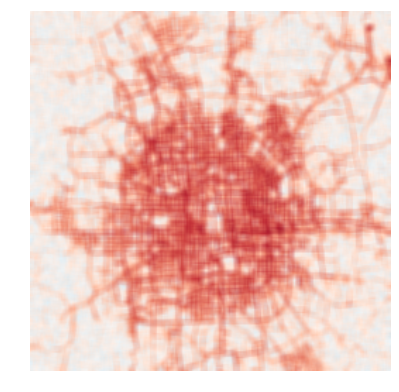

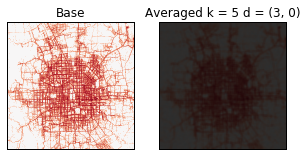

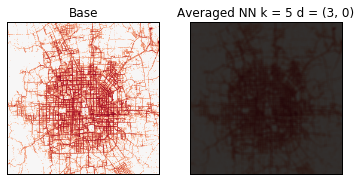

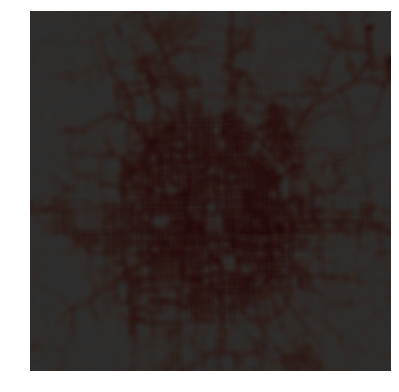

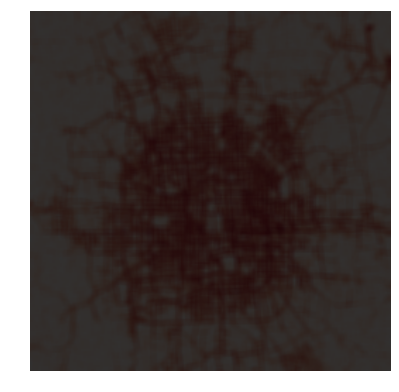

In [33]:
for k in kernelSize:
    for d in denom:
        kernel = np.ones((k,k),np.float32)/(k**d[0]-d[1])
        # Changed divide by kernel^2 (ie. denomiator was 4 -> changed to 3)... this value changes brightness of image??
        dst = cv2.filter2D(img,-1,kernel)
        dstNN = cv2.filter2D(nneg,-1,kernel)

        plotComparison(orig, dst, "Averaged k = {} d = {}".format(k, d))
        plotComparison(orig, dstNN, "Averaged NN k = {} d = {}".format(k, d))
        save_256px(dst, 'TAXI_AVERAGED k = {} d = {}'.format(k, d))
        save_256px(dstNN, 'TAXI_AVERAGED_NN k = {} d = {}'.format(k, d))

# Bilateral

Python: cv2.bilateralFilter(src, d, sigmaColor, sigmaSpace[, dst[, borderType]]) → dst
<br>
Parameters:	
- src – Source 8-bit or floating-point, 1-channel or 3-channel image.
- dst – Destination image of the same size and type as src .
- d – Diameter of each pixel neighborhood that is used during filtering. If it is non-positive, it is computed from sigmaSpace .
- sigmaColor – Filter sigma in the color space. A larger value of the parameter means that farther colors within the pixel neighborhood (see sigmaSpace ) will be mixed together, resulting in larger areas of semi-equal color.
- sigmaSpace – Filter sigma in the coordinate space. A larger value of the parameter means that farther pixels will influence each other as long as their colors are close enough (see sigmaColor ). When d>0 , it specifies the neighborhood size regardless of sigmaSpace . Otherwise, d is proportional to sigmaSpace .
<br>
<br>
bilateralFilter can reduce unwanted noise very well while keeping edges fairly sharp. However, it is very slow compared to most filters.
<br>
<br>
Sigma values: For simplicity, you can set the 2 sigma values to be the same. If they are small (< 10), the filter will not have much effect, whereas if they are large (> 150), they will have a very strong effect, making the image look “cartoonish”.
<br>
<br>
Filter size: Large filters (d > 5) are very slow, so it is recommended to use d=5 for real-time applications, and perhaps d=9 for offline applications that need heavy noise filtering.

In [34]:
diameter = [3, 5, 9, 50]
sigmaColorSpace = [10, 50, 70, 150, 300]

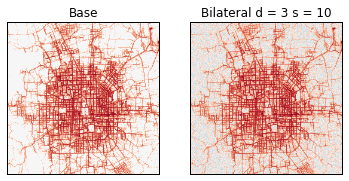

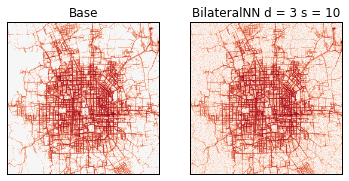

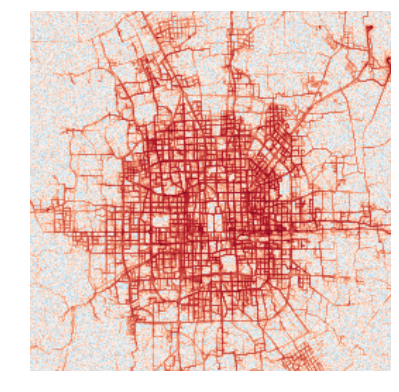

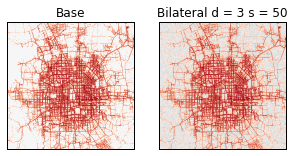

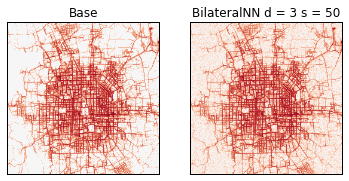

...

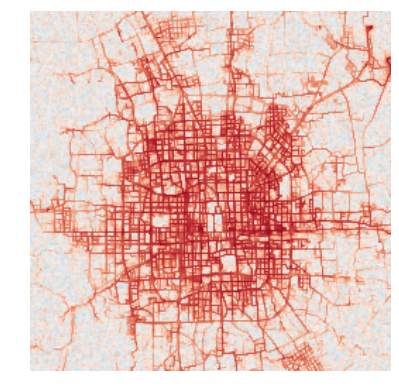

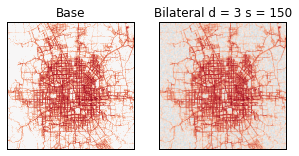

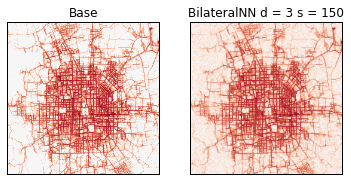

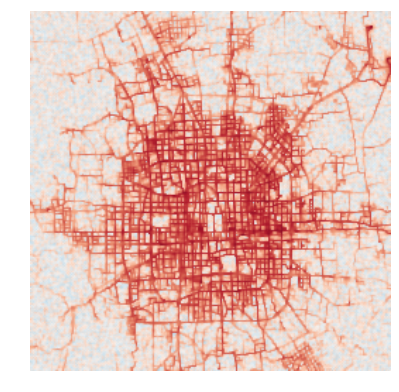

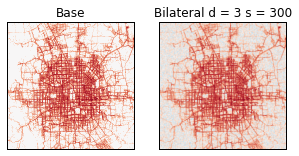

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


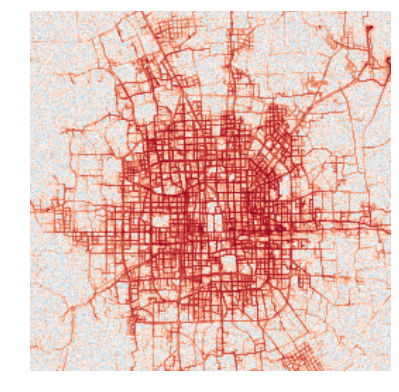

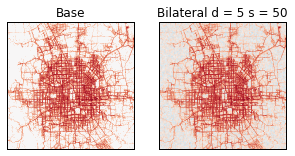

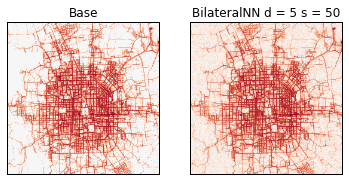

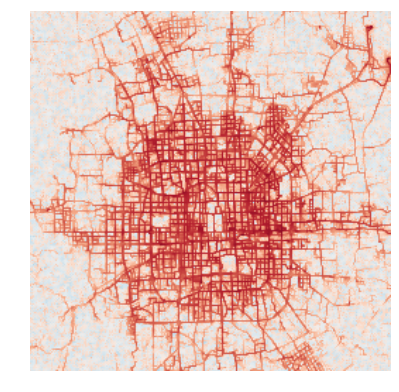

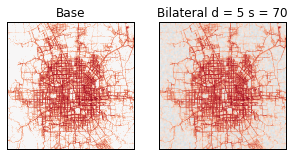

...

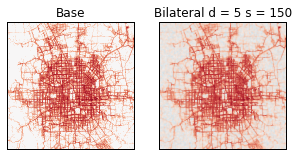

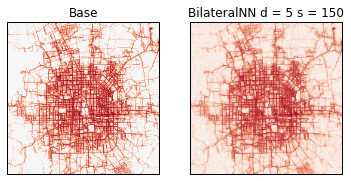

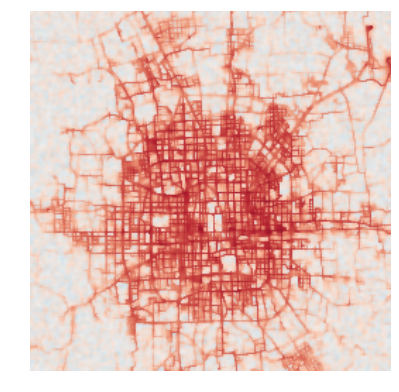

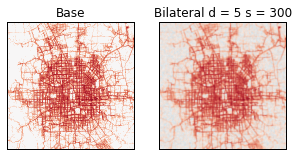

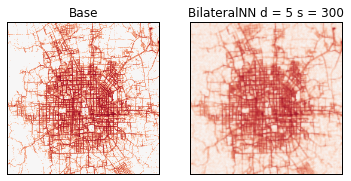

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


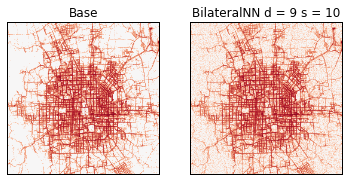

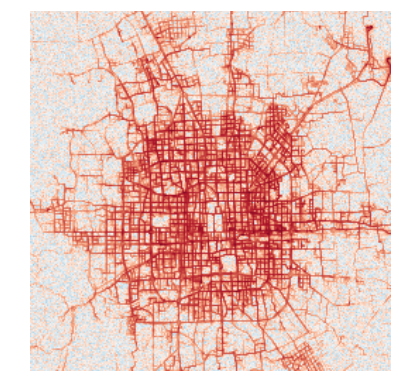

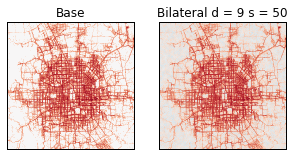

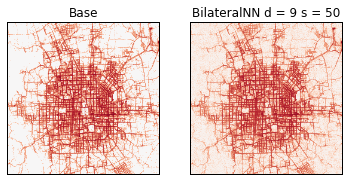

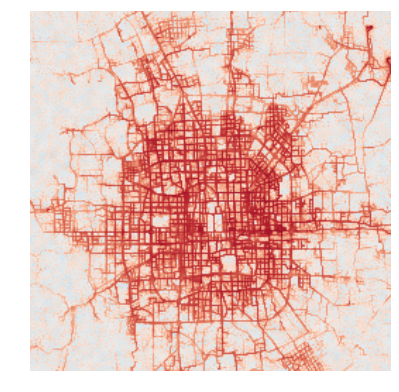

...

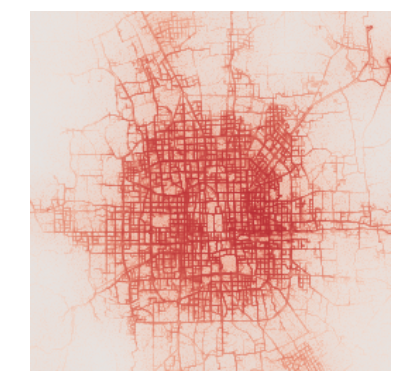

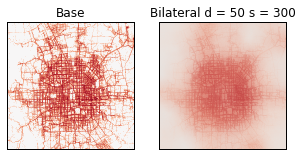

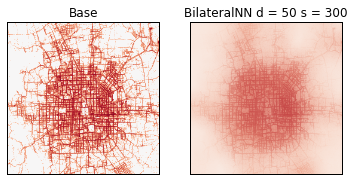

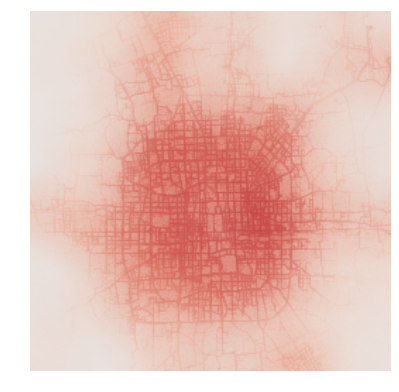

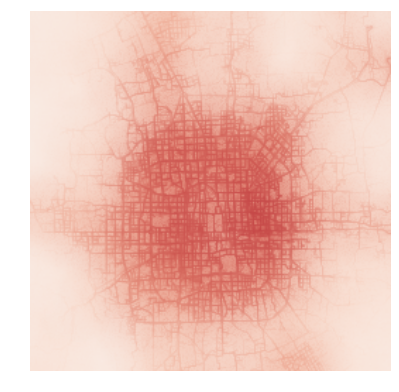

In [35]:
for d in diameter:
    for s in sigmaColorSpace:
        bilateral = cv2.bilateralFilter(img,d,s,s)
        bilateralNN = cv2.bilateralFilter(nneg,d,s,s)

        plotComparison(orig, bilateral, "Bilateral d = {} s = {}".format(d, s))
        plotComparison(orig, bilateralNN, "BilateralNN d = {} s = {}".format(d, s))
        save_256px(bilateral, "TAXI_BILATERAL d = {} s = {}".format(d, s))
        save_256px(bilateralNN, "TAXI_BILATERAL_NN d = {} s = {}".format(d, s))

# Base Images (Twitter Check-In Data)
Original: in.png 
<br>
Noisy epsilon e = 1: out_Identity_e1.png
<br>
Noisy epsilon e = 0.1: out_Identity_e1-1.png

In [36]:
orig = cv2.imread('TwitterData/in.png')
img_1 = cv2.imread('TwitterData/out_Identity_e1.png')
img_01 = cv2.imread('TwitterData/out_Identity_e1E-1.png')

# Averaging

In [37]:
kernelSize = [2, 3, 5]
denom = [(2, 0), (2, 1), (3, 0)]

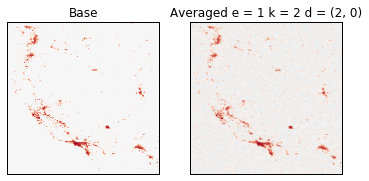

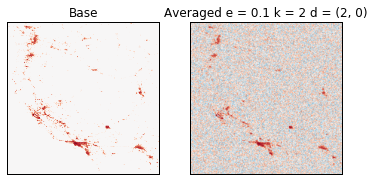

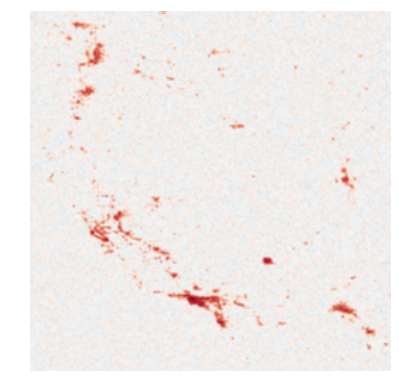

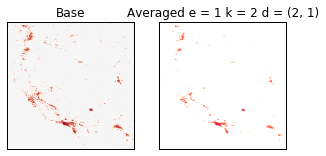

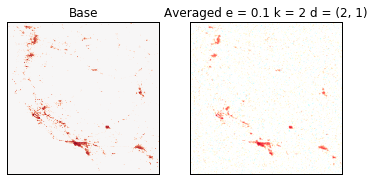

...

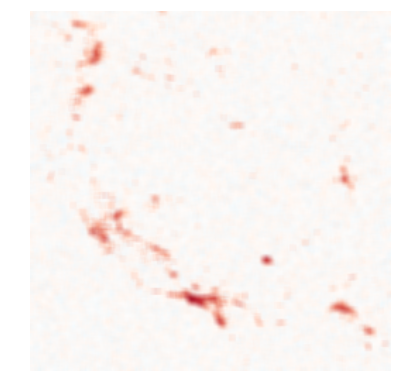

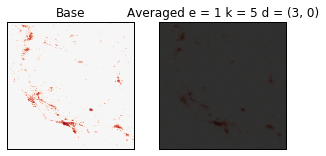

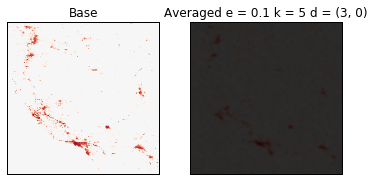

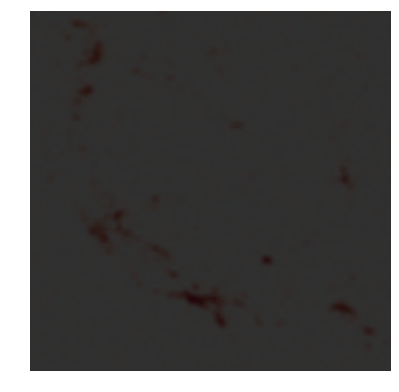

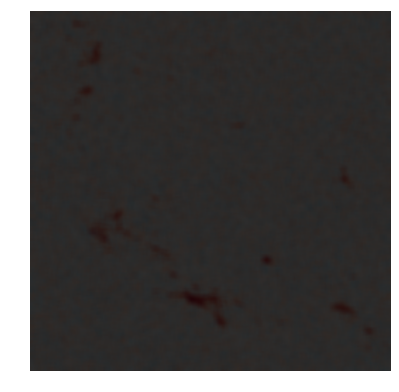

In [38]:
for k in kernelSize:
    for d in denom:
        kernel = np.ones((k, k),np.float32)/(k**d[0]-d[1])
        # Changed divide by kernel^2 (ie. denomiator was 4 -> changed to 3)... this value changes brightness of image??
        dst_1 = cv2.filter2D(img_1,-1,kernel)
        dst_01 = cv2.filter2D(img_01,-1,kernel)

        plotComparison(orig, dst_1, "Averaged e = 1 k = {} d = {}".format(k, d))
        plotComparison(orig, dst_01, "Averaged e = 0.1 k = {} d = {}".format(k, d))
        save_256px(dst_1, 'TWITTER_AVERAGED_1 k = {} d = {}'.format(k, d))
        save_256px(dst_01, 'TWITTER_AVERAGED_01 k = {} d = {}'.format(k, d))

# Bilateral

In [47]:
diameter = [3, 5, 9, 50]
sigmaColorSpace = [10, 50, 70, 150, 300]

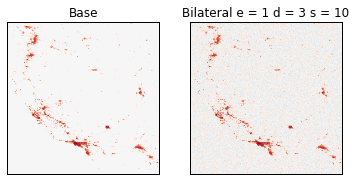

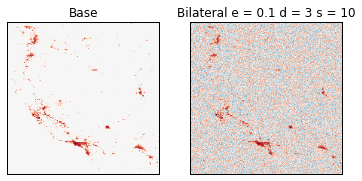

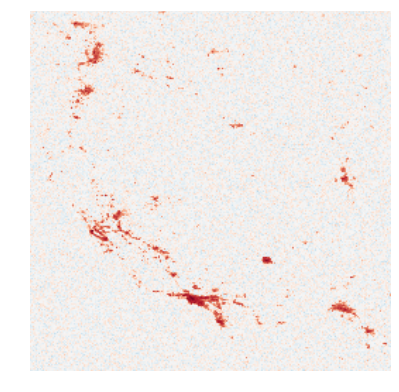

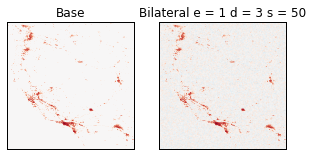

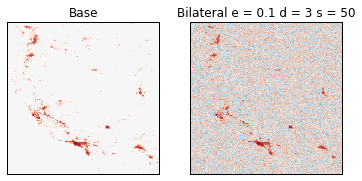

...

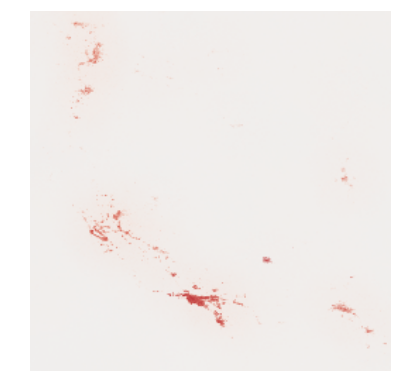

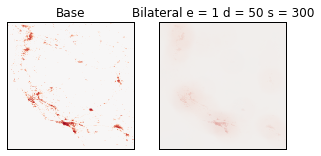

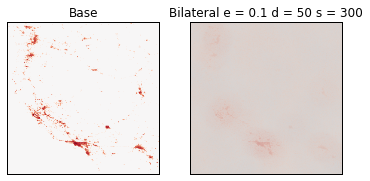

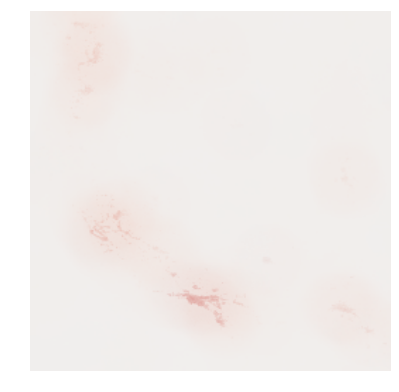

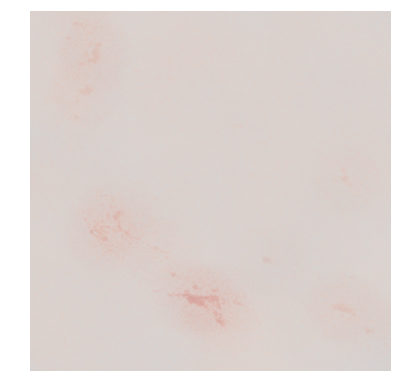

In [50]:
for d in diameter:
    for s in sigmaColorSpace:
        bilateral_1 = cv2.bilateralFilter(img_1,d,s,s)
        bilateral_01 = cv2.bilateralFilter(img_01,d,s,s)
        plotComparison(orig, bilateral_1, "Bilateral e = 1 d = {} s = {}".format(d, s))
        plotComparison(orig, bilateral_01, "Bilateral e = 0.1 d = {} s = {}".format(d, s))
        save_256px(bilateral_1, "TWITTER_BILATERAL_1 d = {} s = {}".format(d, s))
        save_256px(bilateral_01, "TWITTER_BILATERAL_01 d = {} s = {}".format(d, s))